### Defferential Evolution (eralize rosenbrock)




In [1]:
import numpy as np
import random
from array import *
import matplotlib.pyplot as plt
import statistics as st
import math 

In [2]:
D = 10 # Dimensi dari permasalahan
#maxit = 99 #Max iterasi
maxit = 495 #Max iterasi
ukuranPopulasi = 10
LB = -30 #Batas Bawah
UB = 30 #Batas Atas
CR = 0.9 
F = 0.5



In [3]:
import random
def initPopulasi(ukuranPopulasi, D, UB, LB): #Inisialisasi setiap baris kolom
    P = np.empty((ukuranPopulasi,D))
    for i in range(ukuranPopulasi):
        for j in range(D):
            P[i][j]= (random.random()*(UB-LB))+LB
    return P

P = initPopulasi(ukuranPopulasi, D, UB, LB)
print(P)

[[ -7.61081227  16.75428072  13.21043827   9.38809217  25.82375783
   -5.97266     16.72879063  13.07785531   9.79193829   6.31141543]
 [ 14.11978806  20.20459763  26.02100856  18.28858776  22.17751602
    8.0744026   -1.65119132  22.81829131 -10.81018187   7.66739252]
 [-15.10608193   0.97648733   2.78299542  20.21540426 -22.63091213
   -0.22592397 -17.87334542  -8.32939924   7.02288728 -26.12762238]
 [ -7.15930251  17.81181178 -26.86173356  20.98898672  14.43410529
   17.60415444  14.01785515   1.76782069  20.82162597  -2.22402291]
 [-25.67739085  29.91880602  18.05535191   5.13380508 -18.54210928
   -1.38544472   0.03642762 -19.30382664  23.95611823 -25.43411657]
 [ 10.7763051   -8.35561497   6.11354222 -26.7781645  -14.38960392
  -23.84762208 -11.61579588  -8.19720304 -25.1864147   -6.95201705]
 [ -4.62853907  27.95150174  14.55237837  23.55990911   3.19809128
   29.5817369  -23.35268425 -19.60324441  15.03486828  28.29263551]
 [ -8.1061652  -20.93191898  -2.15838804 -18.47794075  

In [4]:
def Fitness_Func(populasi):
    ukuran = populasi.shape
    ukuranPopulasi = ukuran[0]
    dimensi = ukuran[1]
    
    Fobj = np.empty(ukuranPopulasi)
    
    for i in range (ukuranPopulasi):
        d = 0
        for j in range (dimensi):
            #d = d + populasi[i][j]**2
            #d = d + np.sum(np.abs(populasi[i][j])) + np.product(np.abs(populasi[i][j])) #schwefel 2.22
            d = d + np.sum(100*(populasi[i][j]+1)-(populasi[i][j]))**2 + (populasi[i][j]-1)**2 #Generalize rosenbrock
            # d =  d + np.sum( (populasi[i][j]**2) - (10*math.cos(2*math.pi*populasi[i][j])) + 10 ) #rastrigins
        Fobj[i] = d
    return Fobj
    
Fobj = Fitness_Func(P)
print(Fobj)



[20560275.41139579 30795754.29945384 21260650.63404217 27847314.01302745
 37536067.18847232 23447942.13629209 45209389.36433864 37066993.34578882
 32400777.01344717 33057531.1409331 ]


In [5]:
def crossOver(populasi,F,j):
    ukuran = populasi.shape
    ukuranPopulasi = ukuran[0]
    Dimensi = ukuran[1]
    
    r1 = random.randint(0, ukuranPopulasi-1)
    r2 = random.randint(0, ukuranPopulasi-1)
    r3 = random.randint(0, ukuranPopulasi-1)
    
    while r1 == r2:
        r2 = (r2 + 1)%ukuranPopulasi
        
    while r3 == r1 or r3 == r2:
        r3 = (r3 + 1)%ukuranPopulasi
        
    v = P[r3][j] + F*(P[r1][j] - P[r2][j])
    return v

v = crossOver(P,F,1)
print(v)

-19.735526055207696


In [6]:
P = initPopulasi(ukuranPopulasi, D, UB, LB)
print("Inisialisasi Populasi :\n",P)
print(P)

Fobj = Fitness_Func(P)
print(Fobj)
print("\nFungsi Objective :\n",Fobj)

U = np.empty((1,D))
bestFobj = np.empty((maxit+1))
bestFobj[0] = Fobj.min()

for it in range(maxit):
    for i in range(ukuranPopulasi):
        for j in range(D):
            U[0][j] = P[i][j]

        jrand=random.randint(0,D)
        
        for j in range(D):
            if random.random() < CR or j == jrand:
                v = crossOver(P,F,j)
                U[0][j] = v
                
        FobjU = Fitness_Func(U)
        
        if FobjU < Fobj[i]:
            Fobj[i] = FobjU
            for j in range(D):
                P[i][j] = U[0][j]
                
    bestFobj[it+1] = Fobj.min()

    print("\nNilai Optimal : \n",bestFobj)

    for i in range(30):
        bestFobj

Streaming output truncated to the last 5000 lines.
 4.04074231e+001 4.04050816e+001 4.04050816e+001 4.04050816e+001
 4.04032530e+001 4.04032530e+001 4.04028231e+001 4.04028231e+001
 4.04028231e+001 4.04025441e+001 4.04024657e+001 4.04024657e+001
 4.04023898e+001 4.04021328e+001 4.04018571e+001 4.04017783e+001
 4.04017783e+001 4.04017783e+001 4.04017783e+001 4.04017783e+001
 4.04012881e+001 4.04012881e+001 4.04012881e+001 4.04012881e+001
 4.04012881e+001 4.04012881e+001 4.04012881e+001 4.04012266e+001
 4.04012266e+001 4.04012074e+001 4.04011685e+001 4.04011685e+001
 4.04010691e+001 4.04010691e+001 4.04010466e+001 4.04010466e+001
 4.04010466e+001 4.04010466e+001 4.04010466e+001 4.04009850e+001
 4.04009850e+001 4.04009850e+001 4.04009850e+001 4.04009569e+001
 4.04009569e+001 4.04009569e+001 4.04009569e+001 4.04009569e+001
 4.04009569e+001 4.04009569e+001 4.04009566e+001 4.04009566e+001
 4.04009566e+001 4.04009506e+001 4.04009494e+001 4.04009424e+001
 4.04009424e+001 4.04009424e+001 4.0400

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [7]:
import statistics as st
print("Nilai Mean : ",st.mean(bestFobj))
print("Nilai Standard Deviation : ",st.stdev(bestFobj))
print("Nilai Minimal : ",np.min(bestFobj))

Nilai Mean :  382855.90483743796
Nilai Standard Deviation :  1976442.722855424
Nilai Minimal :  40.40093858396244


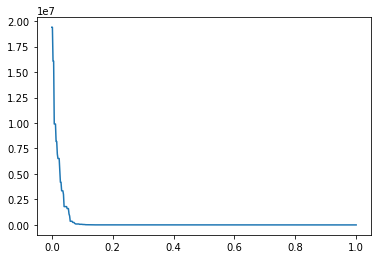

In [8]:
x = np.linspace(0, 1, maxit+1)
plt.plot(x, bestFobj, label= 'f=Fobj')
plt.show()

### Genetic Algorithm

In [9]:
import numpy as np
import random
from array import *
import matplotlib.pyplot as plt
import statistics as st
import math 

In [10]:
N = 3
rows, cols = (N, 4)
induk = [[0 for i in range(cols)] for j in range(rows)]
print (induk)

N_Anak = 6
rows, cols = (N_Anak, 4)
anak = [[0 for i in range(cols)] for j in range(rows)]
print(anak)


[[0, 0, 0, 0], [0, 0, 0, 0], [0, 0, 0, 0]]
[[0, 0, 0, 0], [0, 0, 0, 0], [0, 0, 0, 0], [0, 0, 0, 0], [0, 0, 0, 0], [0, 0, 0, 0]]


In [11]:
#Inisialiasi Parameter
Pc = 0.9
Pm = 0.1

for i in range(N):
    a = random.randint(0, 15)
    induk[i] = [int (x) for x in '{:04b}'.format(a)]
    print(a, induk[i])


13 [1, 1, 0, 1]
12 [1, 1, 0, 0]
7 [0, 1, 1, 1]


In [12]:
#Function cross over
def crossover(ind1=[], ind2=[]):
    anak1 = [0, 0, 0, 0]
    anak2 = [0, 0, 0, 0]
    
    
    anak1[0] = ind1[0]
    anak1[1] = ind1[1]
    anak1[2] = ind2[2]
    anak1[3] = ind2[3]
    
    anak2[0] = ind2[0]
    anak2[1] = ind2[1]
    anak2[2] = ind1[2]
    anak2[3] = ind1[3]
    
    return anak1, anak2


In [13]:
#Function  mutasi
def mutasi(ind=[]):
    ind[1] = 1 - ind[1]
    return ind


In [14]:
#Function hitung Int
def hitungInt(ind = []):
    a = ind[3] * 1
    a = a + ind[2] * 2
    a = a + ind[1] * 4
    a = a + ind[0] * 8
    return a


In [15]:
#Buat function untuk melakukan hitung fitness
def hitungFitness(ind = []):
    a = hitungInt(ind)
    #y = a**2 #sphere
    #y = np.sum(np.abs(a)) + np.product(np.abs(a)) #schwefel 2.22
    y = np.sum(100*(a+1)-(a))**2 + (a-1)**2 #Generalize rosenbrock
    # y = np.sum( (a**2) - (10*math.cos(2*math.pi*a)) + 10 ) #rastrigins

    return y

In [16]:
i = 1
epochs = 495
#epochs = 99
MaxFitness = [0 for i in range(epochs)] 
angkaFitness = [0 for i in range(epochs)]

#nilai fitness induk
for j in range(N):
    if (hitungFitness(induk[j])>MaxFitness[0]):
        MaxFitness[0] = hitungFitness(induk[j])


In [17]:
#'epochs' kali
for i in range(30):
  while i < epochs:
    print("Iterasi: ", i+1)   
    #Reproduksi 
    a = random.random()
    if (a<Pc):
        #Cross over
        anak[0], anak[1] = crossover(induk[0], induk[1])
        anak[2], anak[3] = crossover(induk[0], induk[2])
        anak[4], anak[5] = crossover(induk[1], induk[2])
    else:
        #Mutasi
        for j in range(N):
            induk [j] = mutasi(induk[j])
    #Elistism
    minFitness = 30
    idx = 0
    idxanak = 0
    #minFitness (induk terburuk)
    for j in range(len(induk)):
        if (hitungFitness(induk[j])<minFitness):
            minFitness = hitungFitness(induk[j])
            idx = j
    
    #cari maxFit (Anak terbaik)
    maxFit = -30
    for j in range(len(anak)):
        if (hitungFitness(anak[j])>maxFit):
            maxFit = hitungFitness(anak[j])
            idxanak = j
    #Individual replacement
    if (minFitness < maxFit):
        induk[idx] = anak[idxanak]
    
    #Populasi induk yang paling baik
    for j in range(N):
        if (hitungFitness(induk[j])>MaxFitness[i]):
            MaxFitness[i] = hitungFitness(induk[j])
    i+=1
    
    print(MaxFitness)

Iterasi:  1
[1923913, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Iterasi:  253
[1923913, 1413821, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 251

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Iterasi:  31
[1923913, 1413821, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Iterasi:  191
[1923913, 1413821, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 251

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Iterasi:  43
[1923913, 1413821, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 424
[1923913, 1413821, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Iterasi:  203
[1923913, 1413821, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 251

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[1923913, 1413821, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[1923913, 1413821, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 129
[1923913, 1413821, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Iterasi:  358
[1923913, 1413821, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 2512421, 251

In [18]:
print("Nilai Mean : ", st.mean(MaxFitness))
print("Nilai Standard Deviation : ", st.stdev(MaxFitness))
print("Nilai Minimal : ",np.min(MaxFitness))

Nilai Mean :  2509012
Nilai Standard Deviation :  55969.79841843277
Nilai Minimal :  1413821


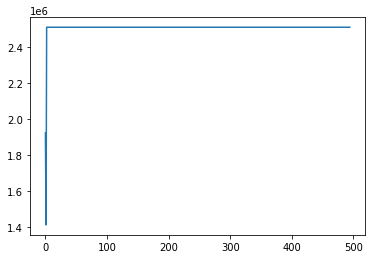

In [19]:
x = [i for i in range(epochs)] 
plt.plot(x, MaxFitness)  